# **Installation of Packages & Importing**

In [ ]:
!pip install mne
!pip install mne-icalabel
!pip install PyWavelets


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 51.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.6/21.6 MB 84.5 MB/s eta 0:00:00


In [ ]:
import matplotlib
import os
import os.path as op
import mne
import numpy as np
import pandas as pd
from mne_icalabel import label_components
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import ShuffleSplit, cross_val_score
import pywt

# **Loading Data**

In [ ]:
eeg_channels =['P8',
 'T8',
 'CP6',
 'FC6',
 'F8',
 'F4',
 'C4',
 'P4',
 'AF4',
 'Fp2',
 'Fp1',
 'AF3',
 'Fz',
 'FC2',
 'Cz',
 'CP2',
 'PO3',
 'O1',
 'Oz',
 'O2',
 'PO4',
 'Pz',
 'CP1',
 'FC1',
 'P3',
 'C3',
 'F3',
 'F7',
 'FC5',
 'CP5',
 'T7',
 'P7']

In [ ]:
raw = mne.io.read_raw_edf('/content/P6.edf', preload=True, infer_types=True)
eeg_raw=raw.pick(mne.pick_channels(raw.info['ch_names'], include=eeg_channels))


Extracting EDF parameters from /content/P6.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<ipython-input-5-c812e0d90b64>:1: RuntimeWarning: Channels contain different highpass filters. Highest filter setting will be stored.
  raw = mne.io.read_raw_edf('/content/P6.edf', preload=True, infer_types=True)


Reading 0 ... 531499  =      0.000 ...  1062.998 secs...


In [ ]:
raw.info['ch_names']

['P8',
 'T8',
 'CP6',
 'FC6',
 'F8',
 'F4',
 'C4',
 'P4',
 'AF4',
 'Fp2',
 'Fp1',
 'AF3',
 'Fz',
 'FC2',
 'Cz',
 'CP2',
 'PO3',
 'O1',
 'Oz',
 'O2',
 'PO4',
 'Pz',
 'CP1',
 'FC1',
 'P3',
 'C3',
 'F3',
 'F7',
 'FC5',
 'CP5',
 'T7',
 'P7']

Using matplotlib as 2D backend.


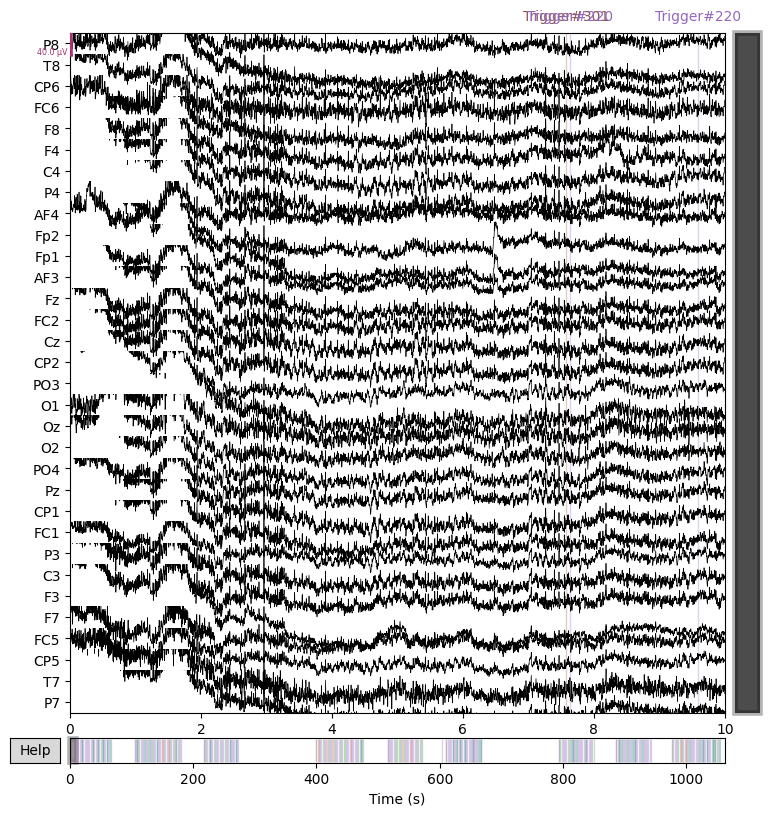

In [ ]:
# import matplotlib.pyplot as plt
# fig = plt.figure(figsize=(50, 20))
inst = eeg_raw.plot(n_channels=40)

In [ ]:
events = mne.events_from_annotations(raw)
triggerTimeStamps = pd.DataFrame(events[0], columns=['Time Stamp', "", "Trigger"]).drop([""], axis = 1)
replaceDict = dict()
for i,j in events[1].items():
  replaceDict[j] = i.replace("Trigger#", "")
triggerTimeStamps.replace(replaceDict, inplace=True)
print("Triggers (With time stamps)\n", triggerTimeStamps)

Used Annotations descriptions: [np.str_('Trigger#100'), np.str_('Trigger#110'), np.str_('Trigger#200'), np.str_('Trigger#220'), np.str_('Trigger#301'), np.str_('Trigger#302'), np.str_('Trigger#303')]
Triggers (With time stamps)
      Time Stamp Trigger
0          3788     301
1          3819     220
2          4797     220
3          5795     220
4          6793     220
..          ...     ...
346      523657     200
347      524652     220
348      525652     220
349      526652     200
350      527131     100

[351 rows x 2 columns]


In [ ]:
len(triggerTimeStamps)

351

In [ ]:
#Set Montage
montage = mne.channels.make_standard_montage('standard_1020')
eeg_raw.set_montage(montage)

<RawEDF | P6.edf, 32 x 531500 (1063.0 s), ~129.8 MiB, data loaded>

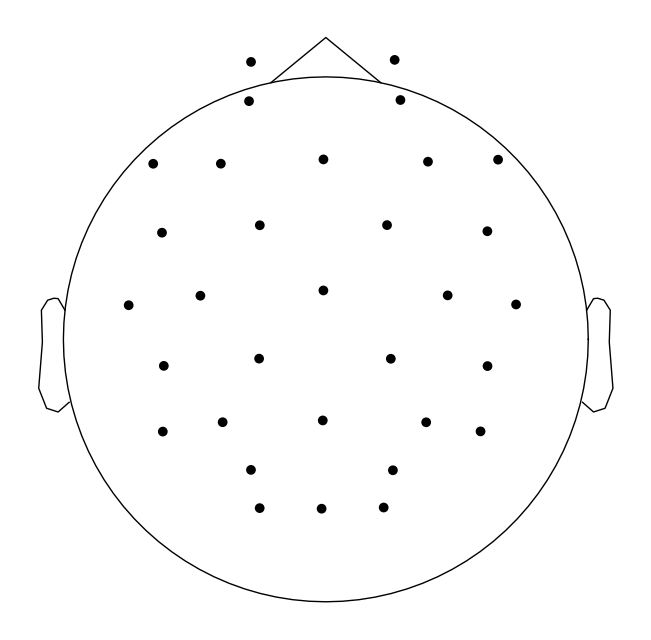

Figure(640x640)


In [ ]:
print(eeg_raw.plot_sensors())

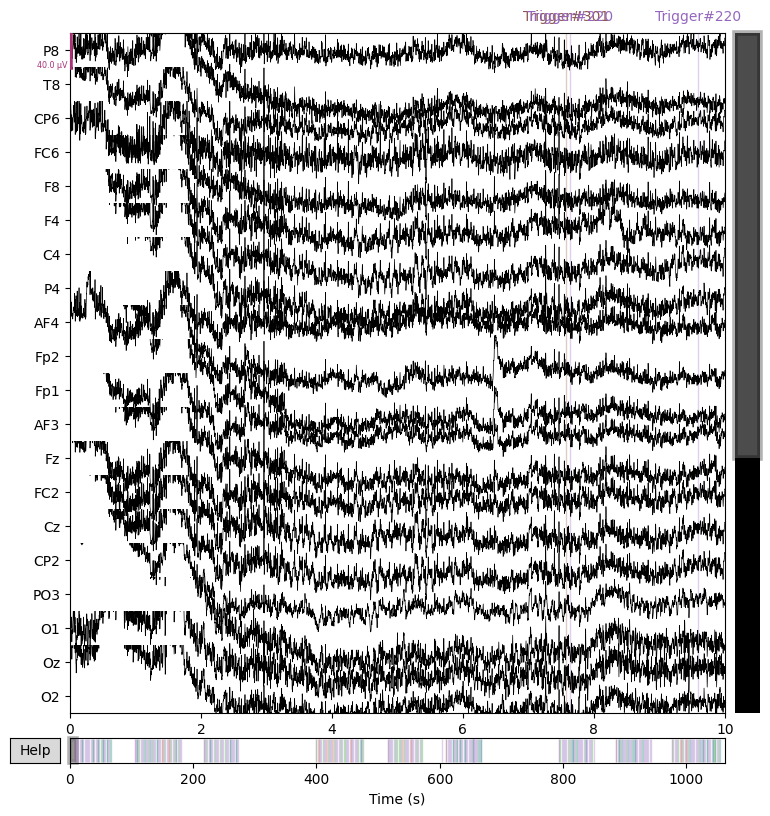

Figure(800x800)


In [ ]:
#plot eeg signal
print(eeg_raw.plot())

# **Plot power spectrum density**

In [ ]:
psd = eeg_raw.compute_psd()

Effective window size : 4.096 (s)


Plotting power spectral density (dB=True).
Figure(1000x350)


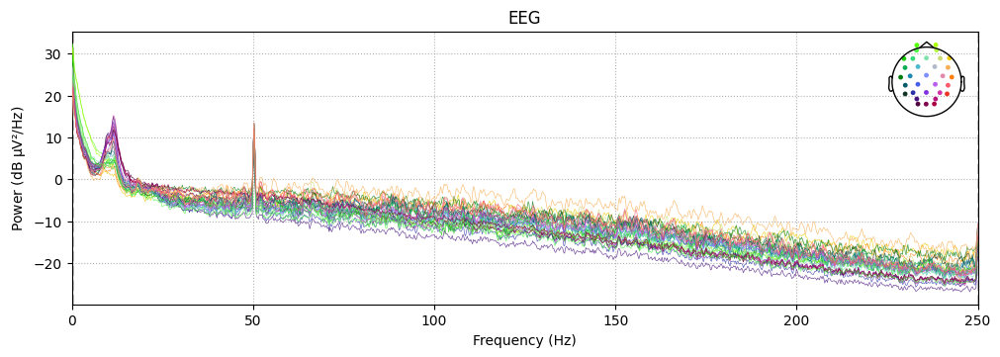

In [ ]:
print(psd.plot())

In [ ]:
bands = {'Delta (0-4 Hz)': (0, 4), 'Theta (4-8 Hz)': (4, 8),
         'Alpha (8-13 Hz)': (8, 13), 'Beta (13-32 Hz)': (13, 32),
         'Gamma (32-100 Hz)': (32, 100)}
i = 0
triggerTime = []
while i < len(triggerTimeStamps):
  if(triggerTimeStamps['Trigger'][i] in ['301', '302', '303']):
    print(f"Trigger Received: {triggerTimeStamps['Trigger'][i]} at time stamp {triggerTimeStamps['Time Stamp'][i]}")
    triggerTime.append([triggerTimeStamps['Trigger'][i], triggerTimeStamps['Time Stamp'][i]])
  i+=1

Trigger Received: 301 at time stamp 3788
Trigger Received: 302 at time stamp 52349
Trigger Received: 303 at time stamp 108434
Trigger Received: 302 at time stamp 199970
Trigger Received: 303 at time stamp 257637
Trigger Received: 301 at time stamp 305408
Trigger Received: 303 at time stamp 396827
Trigger Received: 301 at time stamp 443365
Trigger Received: 302 at time stamp 488649


PSD for 1-back task
Effective window size : 4.096 (s)


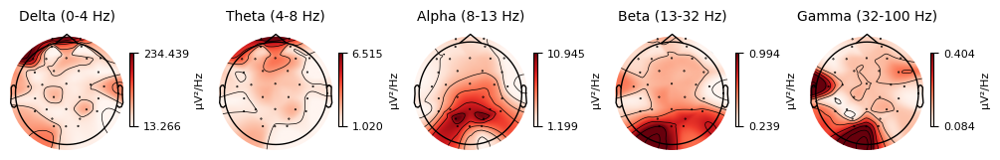

Figure(1000x150)
PSD for 2-back task
Effective window size : 4.096 (s)


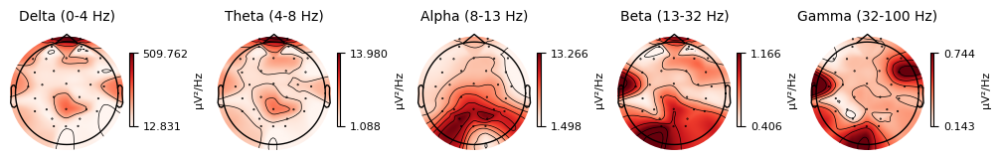

Figure(1000x150)
PSD for 3-back task
Effective window size : 4.096 (s)


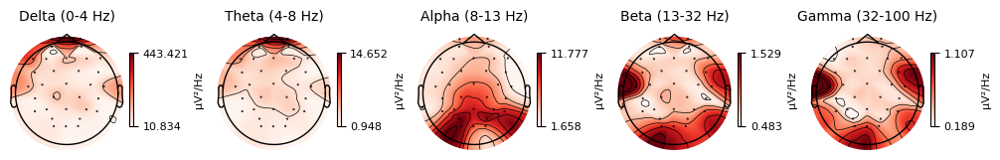

Figure(1000x150)
----------------------------------------------------------------End of Trial 1---------------------------------------------------------------
PSD for 2-back task
Effective window size : 4.096 (s)


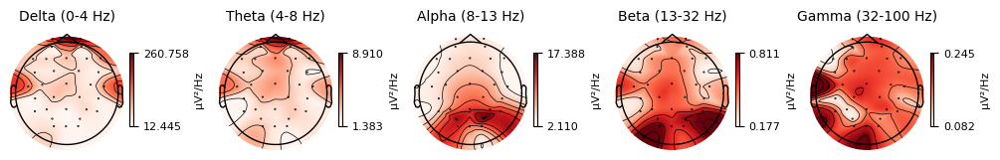

Figure(1000x150)
PSD for 3-back task
Effective window size : 4.096 (s)


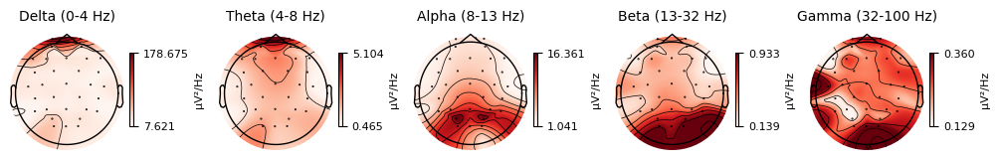

Figure(1000x150)
PSD for 1-back task
Effective window size : 4.096 (s)


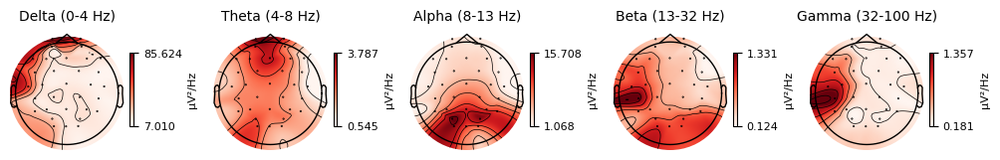

Figure(1000x150)
----------------------------------------------------------------End of Trial 2---------------------------------------------------------------
PSD for 3-back task
Effective window size : 4.096 (s)


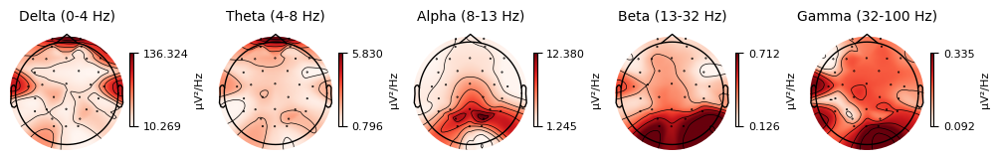

Figure(1000x150)
PSD for 1-back task
Effective window size : 4.096 (s)


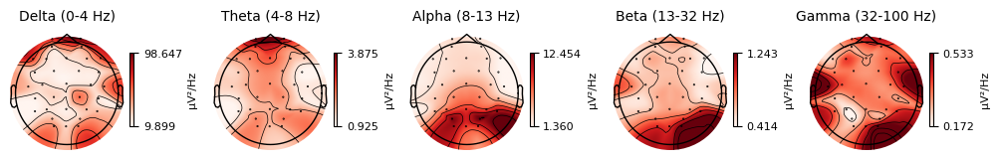

Figure(1000x150)
PSD for 2-back task
Effective window size : 4.096 (s)


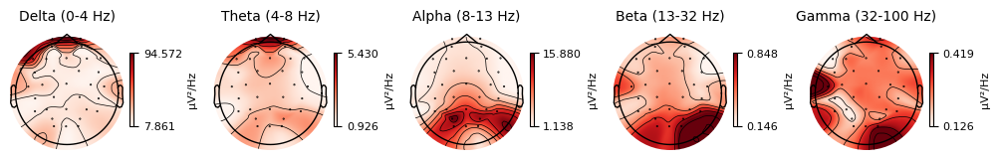

Figure(1000x150)
----------------------------------------------------------------End of Trial 3---------------------------------------------------------------


In [ ]:

startTimeStamp = 0
endTimeStamp = 0
tStart = 0
tEnd = 0
count = 0
for i in range(0,len(triggerTime)):
  count+=1
  isEndOfTrial = int(count%3 == 0)
  startTimeStamp = triggerTime[i][1]
  try:
    endTimeStamp = triggerTime[i+1][1]
  except:
    endTimeStamp = 531499
  tStart = startTimeStamp/500
  tEnd = endTimeStamp/500
  tEnd -= 30*(1-isEndOfTrial) + 120*isEndOfTrial
  if(i == len(triggerTime)-1):
    tEnd = endTimeStamp/500
  print(f"PSD for {triggerTime[i][0][-1]}-back task")
  print(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd).plot_topomap(bands)) ###################################
  if(isEndOfTrial):
    print(f"----------------------------------------------------------------End of Trial {count//3}---------------------------------------------------------------")


In [ ]:
eeg_raw.filter(1.,100.)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 1651 samples (3.302 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.4s
[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    0.8s finished


<RawEDF | P6.edf, 32 x 531500 (1063.0 s), ~129.8 MiB, data loaded>

NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 4.096 (s)
Plotting power spectral density (dB=True).
Figure(1000x350)


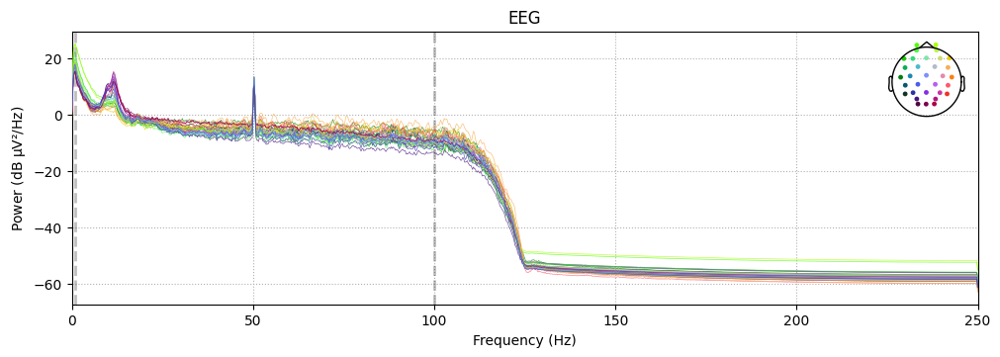

In [ ]:
#plot after filter
print(eeg_raw.plot_psd())

In [ ]:
eeg_raw.notch_filter(50, p_value=0.001)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 3301 samples (6.602 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    0.7s finished


<RawEDF | P6.edf, 32 x 531500 (1063.0 s), ~129.8 MiB, data loaded>

NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 4.096 (s)
Plotting power spectral density (dB=True).
Figure(1000x350)


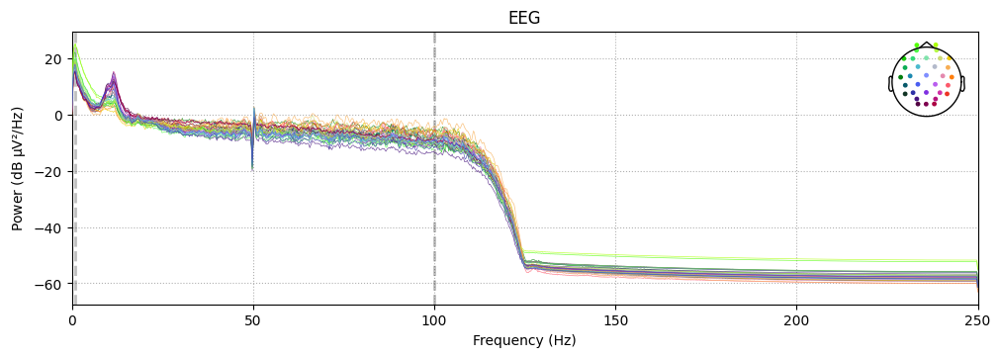

In [ ]:
print(eeg_raw.plot_psd())

NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 4.096 (s)
Plotting power spectral density (dB=True).
Figure(1000x350)


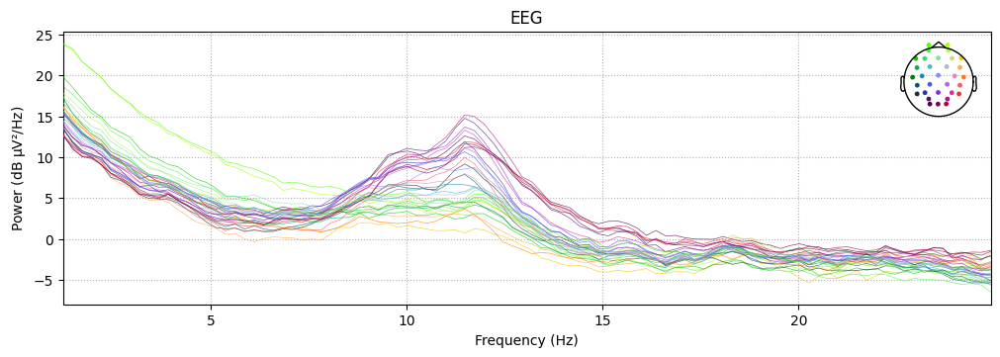

In [ ]:
print(eeg_raw.plot_psd(fmin=1,fmax=25))

#**Create epoch of -1 sec to 2 sec.**

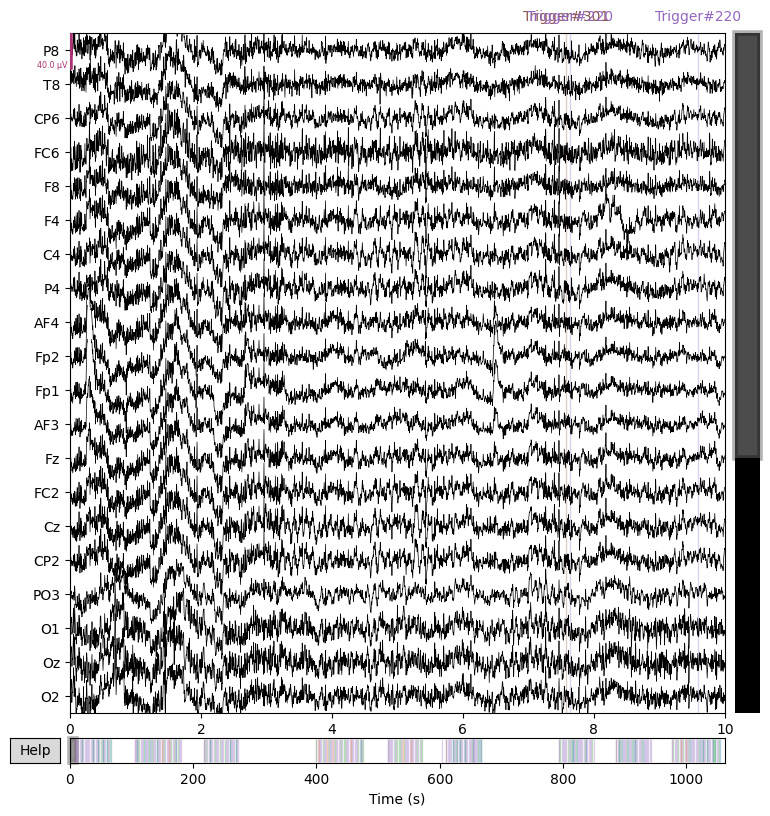

Figure(800x800)


In [ ]:
print(eeg_raw.plot())

In [ ]:
deltaBP = []
thetaBP = []
alphaBP = []
betaBP = []
gammaBP = []
xLabels = []
startTimeStamp = 0
endTimeStamp = 0
tStart = 0
tEnd = 0
count = 0
for i in range(0,len(triggerTime)):
  count+=1
  isEndOfTrial = int(count%3 == 0)
  startTimeStamp = triggerTime[i][1]
  try:
    endTimeStamp = triggerTime[i+1][1]
  except:
    endTimeStamp = 531499

  tStart = startTimeStamp/500
  tEnd = endTimeStamp/500
  tEnd -= 30*(1-isEndOfTrial) + 120*isEndOfTrial
  if(i == len(triggerTime)-1):
    tEnd = endTimeStamp/500
  # print(f"PSD for {triggerTime[i][0][-1]}-back task")
  xLabels.append(f"{triggerTime[i][0][-1]}-back task")
  deltaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=0, fmax = 4)))))
  thetaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=4, fmax = 8)))))
  alphaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=8, fmax = 13)))))
  betaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=13, fmax = 32)))))
  gammaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=32, fmax = 100)))))
  tStart = tEnd
  tEnd += 30*(1-isEndOfTrial) + 120*isEndOfTrial
  if(i != len(triggerTime)-1):
    xLabels.append(f"{30*(1-isEndOfTrial) + 120*isEndOfTrial}s break")
    deltaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=0, fmax = 4)))))
    thetaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=4, fmax = 8)))))
    alphaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=8, fmax = 13)))))
    betaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=13, fmax = 32)))))
    gammaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=32, fmax = 100)))))
  if(isEndOfTrial):
    print(f"----------------------------------------------------------------End of Trial {count//3}---------------------------------------------------------------")


Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective wind

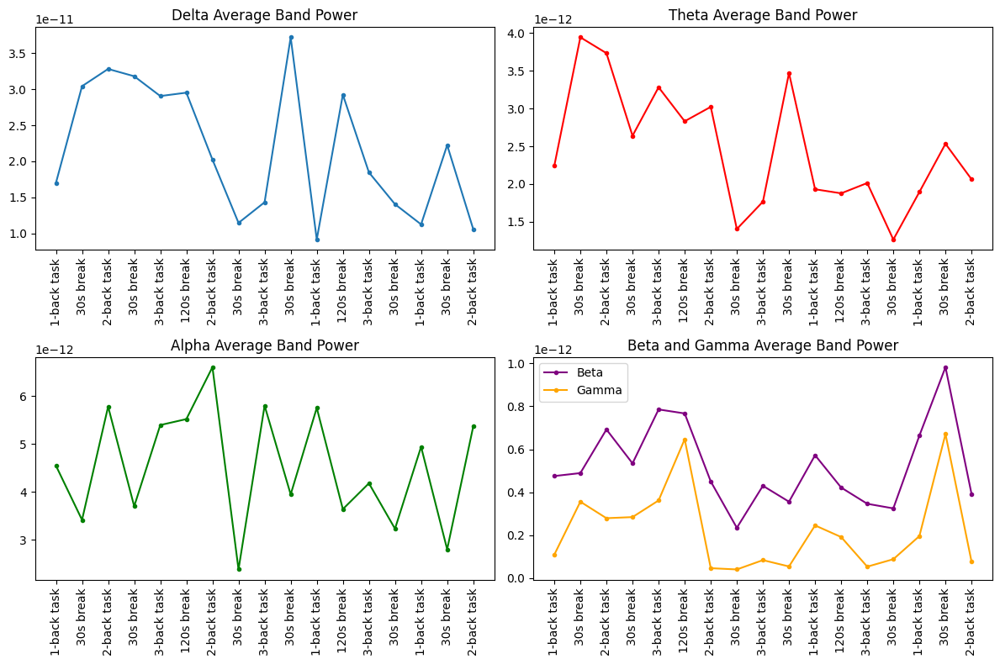

In [ ]:
import matplotlib.pyplot as plt
fig = plt.figure(figsize = (12,8))

ax1 = fig.add_subplot(2,2,1)
ax1.plot(range(len(xLabels)),deltaBP, marker=".")
plt.title("Delta Average Band Power")
plt.xticks(range(len(xLabels)),xLabels,rotation=90)

ax2 = fig.add_subplot(2,2,2)
ax2.plot(range(len(xLabels)),thetaBP, marker=".", c='r')
plt.title("Theta Average Band Power")
plt.xticks(range(len(xLabels)),xLabels,rotation=90)

ax3 = fig.add_subplot(2,2,3)
ax3.plot(range(len(xLabels)),alphaBP, marker=".", c='g')
plt.title("Alpha Average Band Power")
plt.xticks(range(len(xLabels)),xLabels,rotation=90)

ax4 = fig.add_subplot(2,2,4)
ax4.plot(range(len(xLabels)),betaBP, marker=".", c='purple')
ax4.plot(range(len(xLabels)),gammaBP, marker=".", c='orange')
plt.title("Beta and Gamma Average Band Power")
plt.xticks(range(len(xLabels)),xLabels,rotation=90)

# plt.title("Trends of average band power for the course of the experiment")
# plt.xticks(range(len(xLabels)),xLabels,rotation=90)
plt.legend(labels=['Beta', 'Gamma'])
plt.tight_layout()

PSD for 1-back task
Effective window size : 4.096 (s)


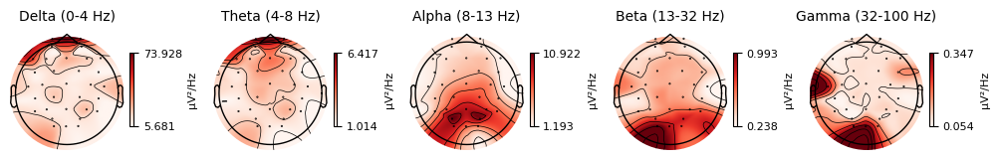

Figure(1000x150)
PSD for 2-back task
Effective window size : 4.096 (s)


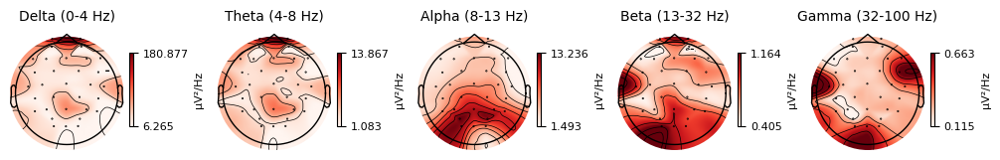

Figure(1000x150)
PSD for 3-back task
Effective window size : 4.096 (s)


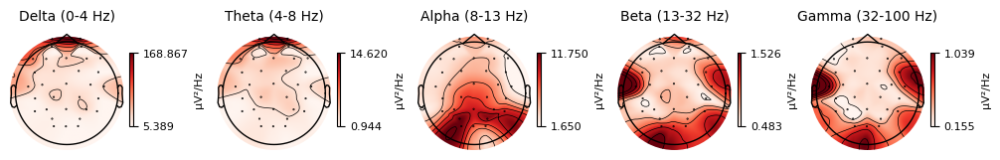

Figure(1000x150)
----------------------------------------------------------------End of Trial 1---------------------------------------------------------------
PSD for 2-back task
Effective window size : 4.096 (s)


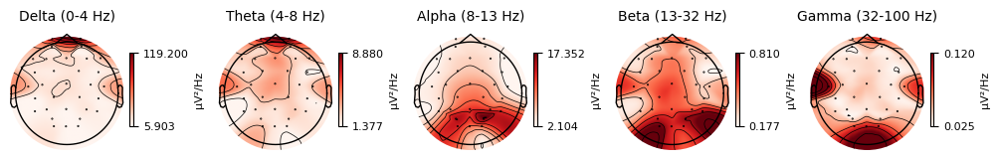

Figure(1000x150)
PSD for 3-back task
Effective window size : 4.096 (s)


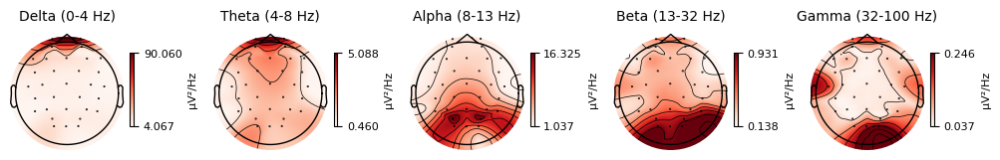

Figure(1000x150)
PSD for 1-back task
Effective window size : 4.096 (s)


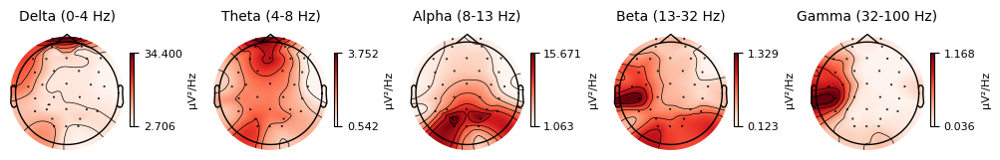

Figure(1000x150)
----------------------------------------------------------------End of Trial 2---------------------------------------------------------------
PSD for 3-back task
Effective window size : 4.096 (s)


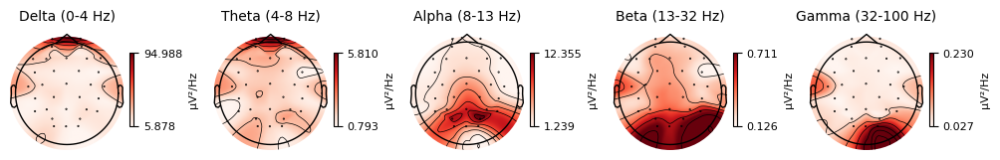

Figure(1000x150)
PSD for 1-back task
Effective window size : 4.096 (s)


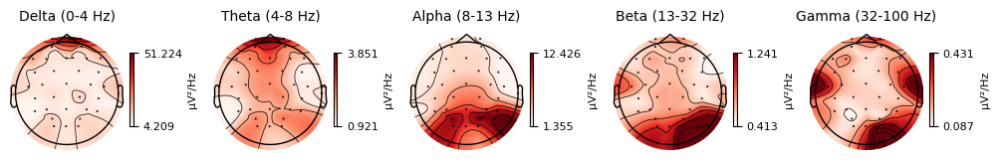

Figure(1000x150)
PSD for 2-back task
Effective window size : 4.096 (s)


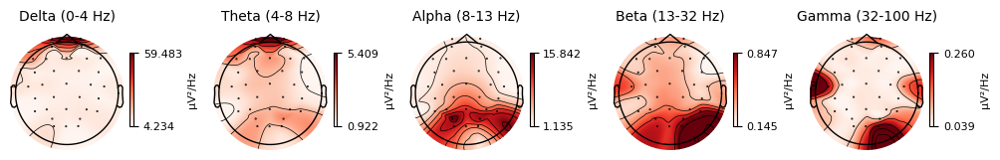

Figure(1000x150)
----------------------------------------------------------------End of Trial 3---------------------------------------------------------------


In [ ]:
triggerTime
startTimeStamp = 0
endTimeStamp = 0
tStart = 0
tEnd = 0
count = 0
for i in range(0,len(triggerTime)):
  count+=1
  isEndOfTrial = int(count%3 == 0)
  startTimeStamp = triggerTime[i][1]
  try:
    endTimeStamp = triggerTime[i+1][1]
  except:
    endTimeStamp = 531499
  tStart = startTimeStamp/500
  tEnd = endTimeStamp/500
  tEnd -= 30*(1-isEndOfTrial) + 120*isEndOfTrial
  if(i == len(triggerTime)-1):
    tEnd = endTimeStamp/500
  print(f"PSD for {triggerTime[i][0][-1]}-back task")
  print(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd).plot_topomap(bands)) ############################################
  if(isEndOfTrial):
    print(f"----------------------------------------------------------------End of Trial {count//3}---------------------------------------------------------------")


In [ ]:
(events,event_dict )= mne.events_from_annotations(eeg_raw)

imagined_event_dict ={}
for x,y in event_dict.items():
    if x.find("Trigger#100")>=0 or x.find("Trigger#110") >=0 or x.find("Trigger#200") >=0 or  x.find("Trigger#220") >=0:
    # if x.find("Marker_rest")>=0 or x.find("label_AS") >=0 :
        imagined_event_dict[x]=y

reject_criteria = dict(eeg=450e-6)                              # Absolute Amplitude of each epoch sould be smaller than 100 μV
                                                                # tmin is start time before event, tmax is end time after event
                                                                # - 100 ms (baseline) of cue's onset to 600 ms

epochs = mne.Epochs(eeg_raw, events, event_id=imagined_event_dict, tmin=-1, tmax=2,
                    reject=reject_criteria, baseline = (None,0), preload=True, picks=['eeg'])
epochs.set_eeg_reference() # Common Average reference

Used Annotations descriptions: [np.str_('Trigger#100'), np.str_('Trigger#110'), np.str_('Trigger#200'), np.str_('Trigger#220'), np.str_('Trigger#301'), np.str_('Trigger#302'), np.str_('Trigger#303')]
Not setting metadata
342 matching events found
Setting baseline interval to [-1.0, 0.0] s
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 342 events and 1501 original time points ...
    Rejecting  epoch based on EEG : ['Fp2', 'Fp1', 'F7']
    Rejecting  epoch based on EEG : ['Fp2', 'Fp1', 'F7']
    Rejecting  epoch based on EEG : ['Fp2', 'Fp1']
    Rejecting  epoch based on EEG : ['Fp2', 'Fp1']
    Rejecting  epoch based on EEG : ['Fp2']
    Rejecting  epoch based on EEG : ['Fp2']
    Rejecting  epoch based on EEG : ['Fp2']
    Rejecting  epoch based on EEG : ['Fp2']
    Rejecting  epoch based on EEG : ['CP5']
    Rejecting  epoch based on EEG : ['CP5']
10 bad epochs dropped
EEG channel type selected for re-referencing
Applying aver

<Epochs | 332 events (all good), -1 – 2 s (baseline -1 – 0 s), ~121.7 MiB, data loaded,
 np.str_('Trigger#100'): 38
 np.str_('Trigger#110'): 10
 np.str_('Trigger#200'): 71
 np.str_('Trigger#220'): 213>

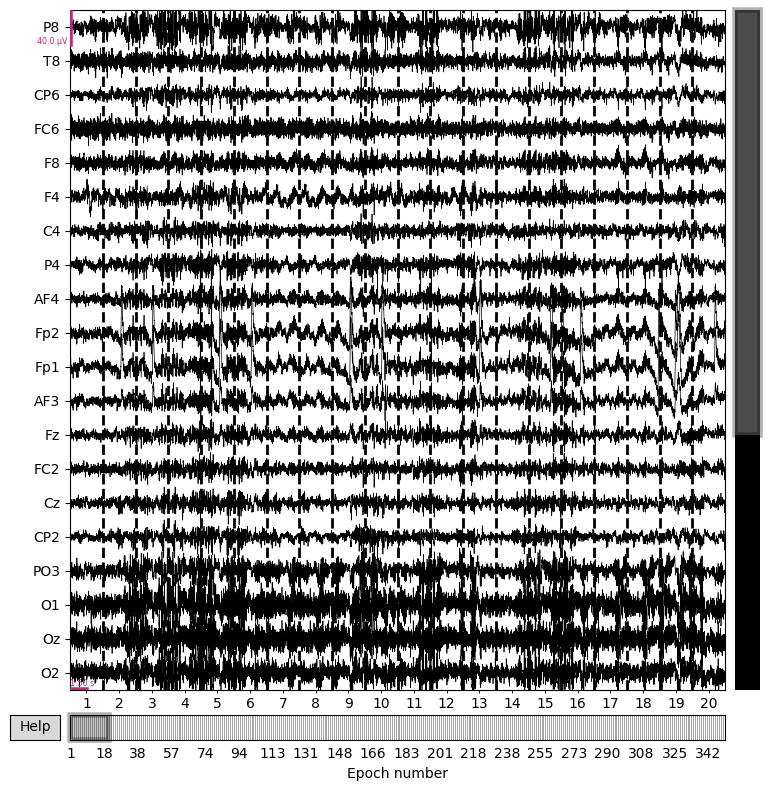

Figure(800x800)


In [ ]:
print(epochs.plot())

NOTE: plot_psd_topomap() is a legacy function. New code should use .compute_psd().plot_topomap().
    Using multitaper spectrum estimation with 7 DPSS windows
Averaging across epochs before plotting...


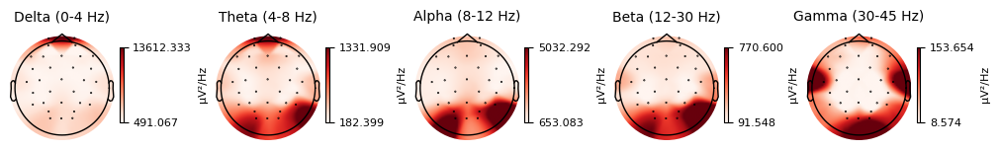

Figure(1000x150)


In [ ]:
print(epochs.plot_psd_topomap())

In [ ]:
np.array(list(epochs)).shape

(332, 32, 1501)

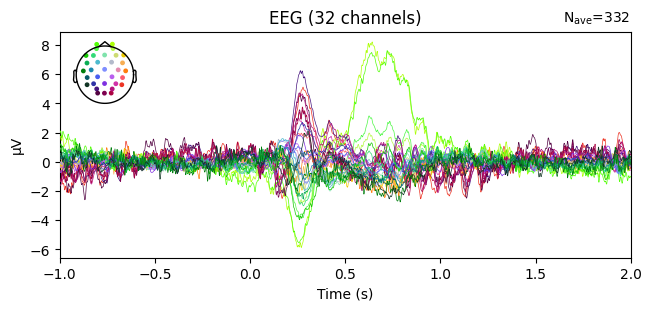

Figure(640x300)


In [ ]:
print(epochs.average().plot())

Applying baseline correction (mode: mean)


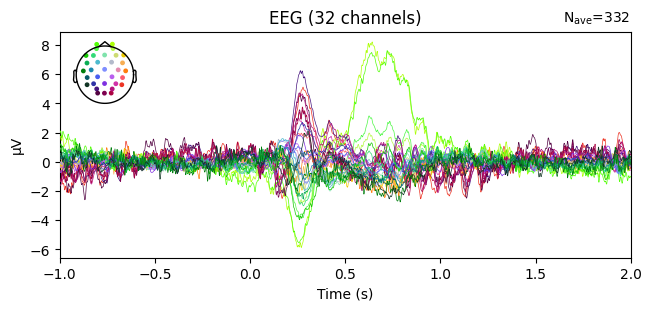

Figure(640x300)


In [ ]:
inteval = (-1, 0)
bc_epochs = epochs.apply_baseline(inteval)
print(bc_epochs.average().plot())

# **Comparing raw and epoched psd**

    Using multitaper spectrum estimation with 7 DPSS windows
Plotting power spectral density (dB=True).
Averaging across epochs before plotting...
Figure(1000x350)


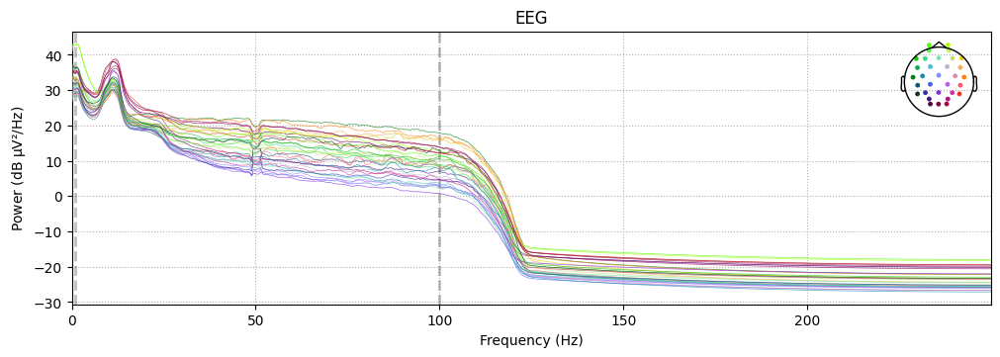

In [ ]:
print(epochs.compute_psd().plot())

Effective window size : 4.096 (s)
Plotting power spectral density (dB=True).
Figure(1000x350)


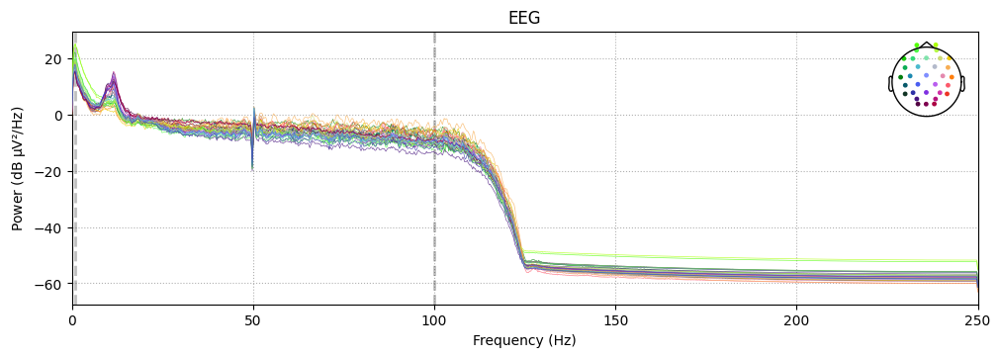

In [ ]:
print(eeg_raw.compute_psd().plot())

In [ ]:
# print(epochs.compute_psd().plot_topomap())

In [ ]:
# print(eeg_raw.compute_psd().plot_topomap())

# **ICA**

<ICA | no decomposition, method: infomax>
Fitting ICA to data using 32 channels (please be patient, this may take a while)
    Rejecting  epoch based on EEG : ['Fp1']
Artifact detected in [15100, 15200]
Selecting by number: 15 components
Computing Extended Infomax ICA
Fitting ICA took 32.1s.
<ICA | raw data decomposition, method: infomax (fit in 500 iterations on 53000 samples), 15 ICA components (32 PCA components available), channel types: eeg, no sources marked for exclusion>


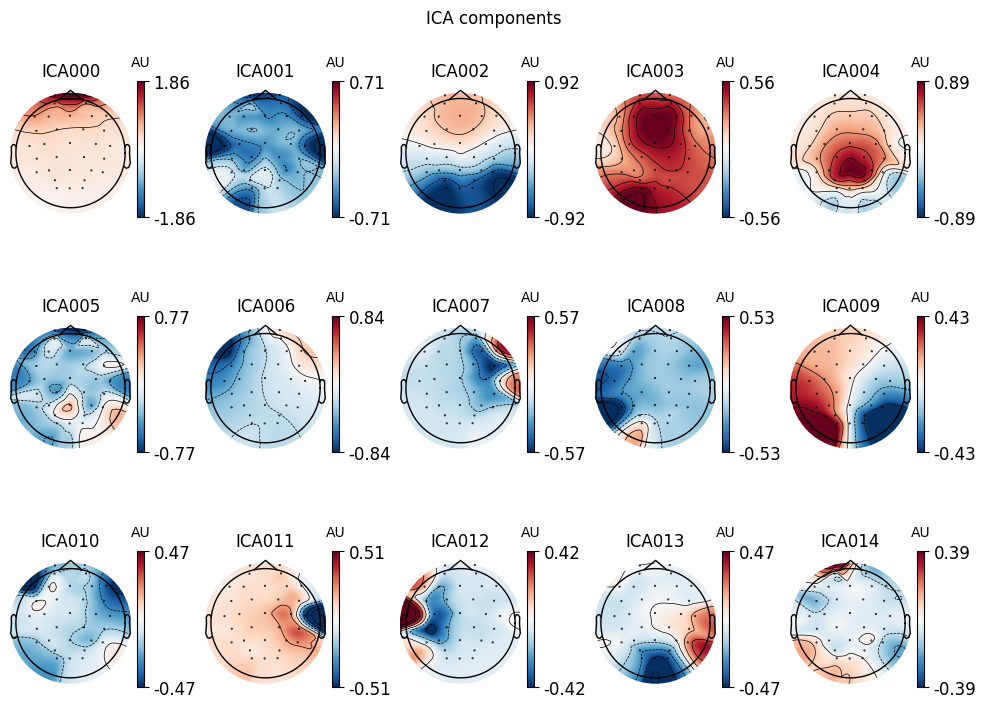









<ICA | no decomposition, method: infomax>
Fitting ICA to data using 32 channels (please be patient, this may take a while)
    Rejecting  epoch based on EEG : ['Fp1']
Artifact detected in [15100, 15200]
Selecting by number: 16 components
Computing Extended Infomax ICA
Fitting ICA took 18.4s.
<ICA | raw data decomposition, method: infomax (fit in 500 iterations on 53000 samples), 16 ICA components (32 PCA components available), channel types: eeg, no sources marked for exclusion>


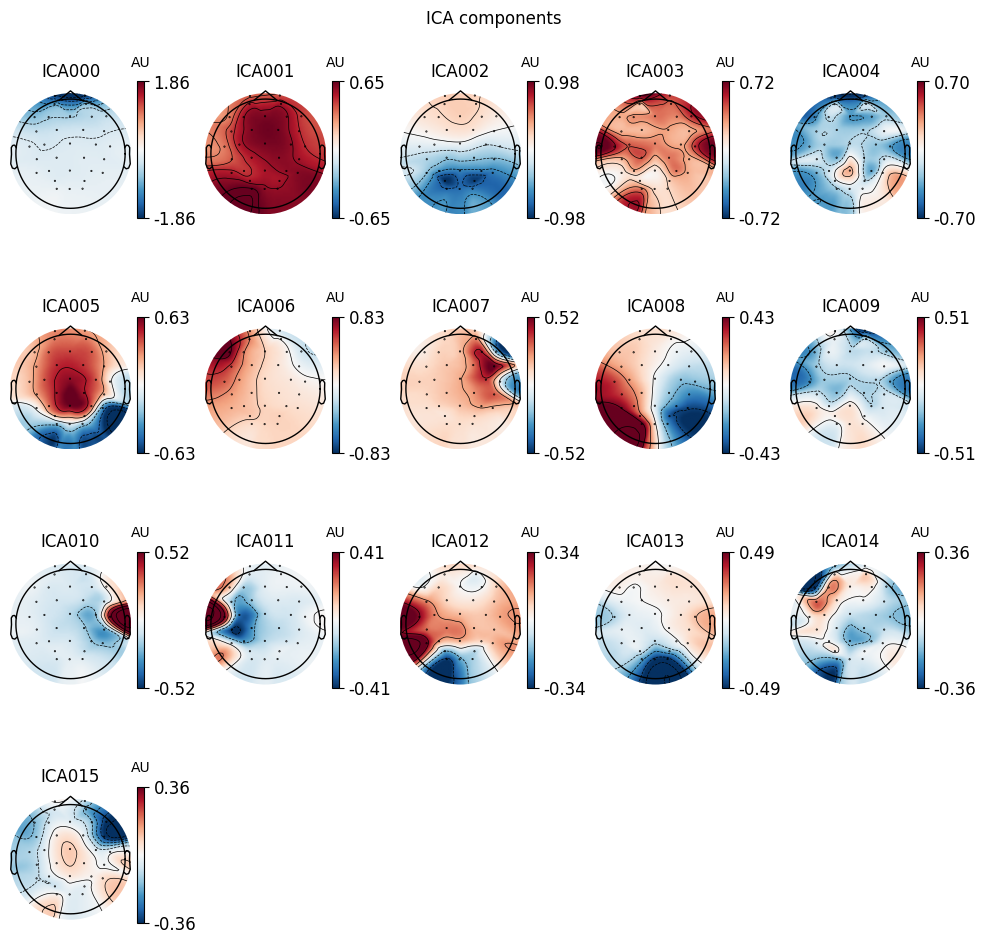









<ICA | no decomposition, method: infomax>
Fitting ICA to data using 32 channels (please be patient, this may take a while)
    Rejecting  epoch based on EEG : ['Fp1']
Artifact detected in [15100, 15200]
Selecting by number: 17 components
Computing Extended Infomax ICA
Fitting ICA took 20.8s.
<ICA | raw data decomposition, method: infomax (fit in 500 iterations on 53000 samples), 17 ICA components (32 PCA components available), channel types: eeg, no sources marked for exclusion>


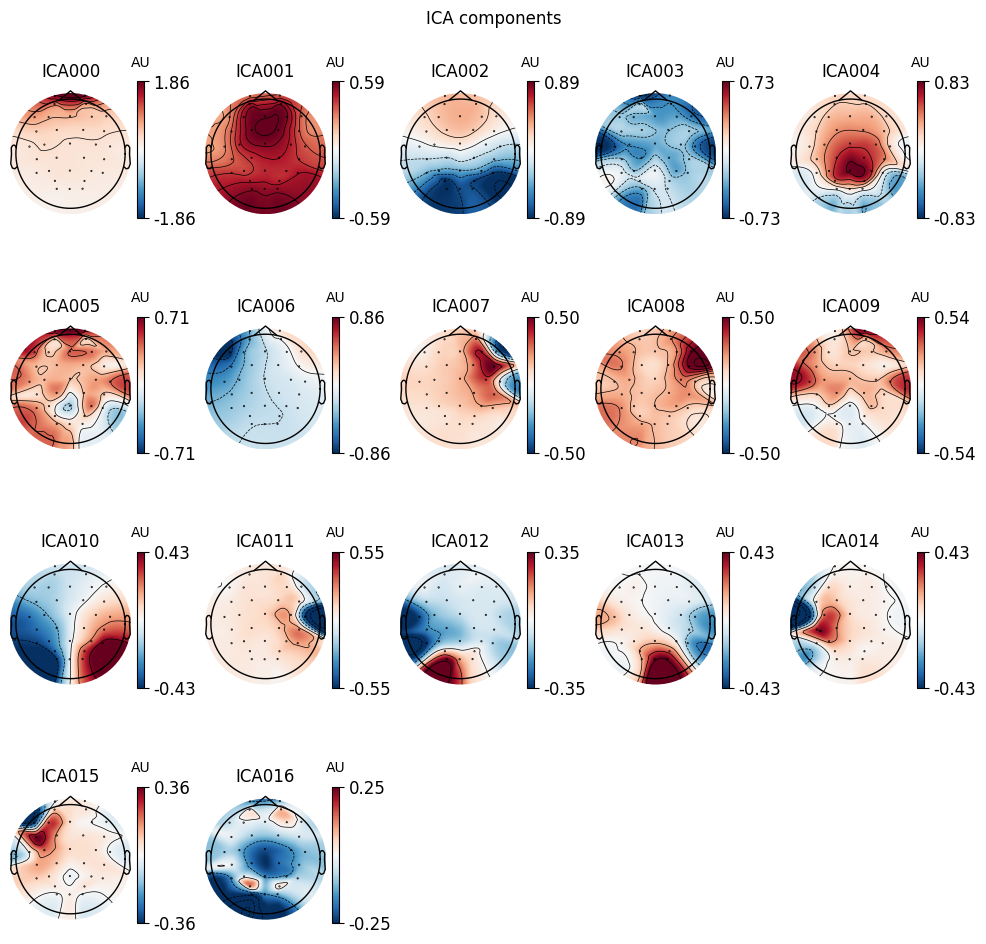









<ICA | no decomposition, method: infomax>
Fitting ICA to data using 32 channels (please be patient, this may take a while)
    Rejecting  epoch based on EEG : ['Fp1']
Artifact detected in [15100, 15200]
Selecting by number: 18 components
Computing Extended Infomax ICA
Fitting ICA took 18.4s.
<ICA | raw data decomposition, method: infomax (fit in 500 iterations on 53000 samples), 18 ICA components (32 PCA components available), channel types: eeg, no sources marked for exclusion>


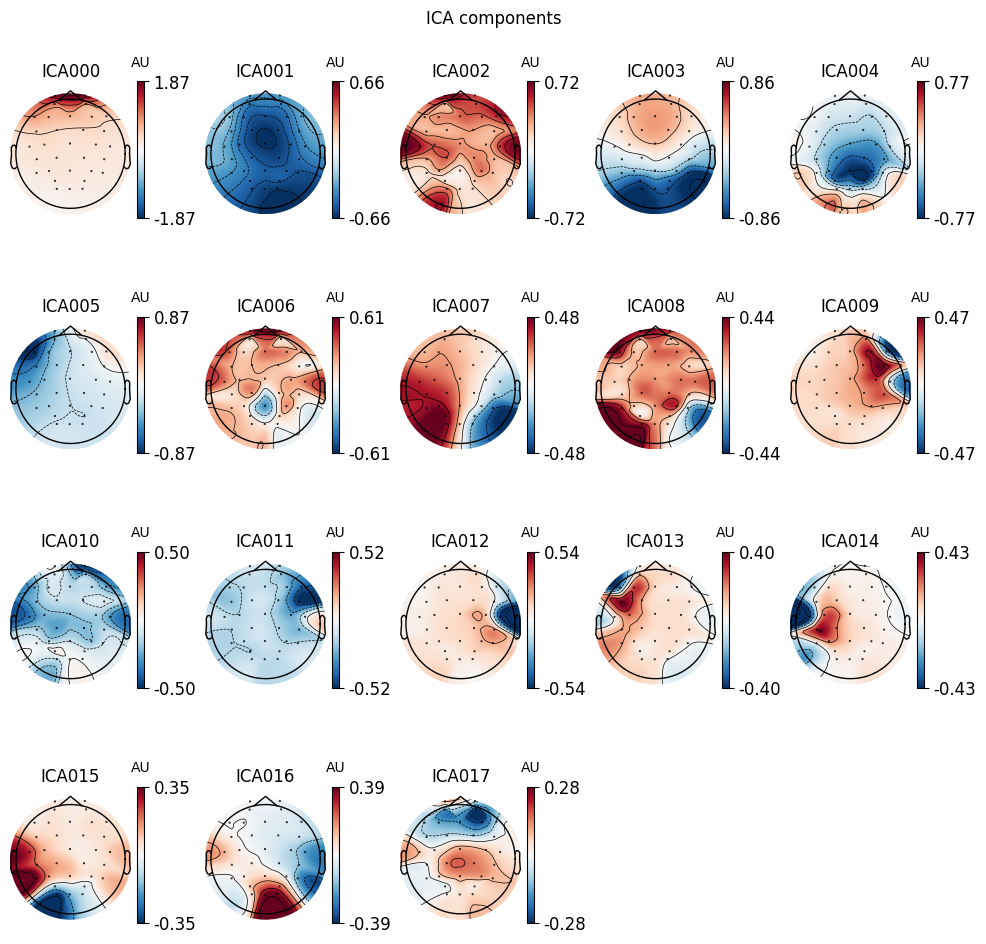









<ICA | no decomposition, method: infomax>
Fitting ICA to data using 32 channels (please be patient, this may take a while)
    Rejecting  epoch based on EEG : ['Fp1']
Artifact detected in [15100, 15200]
Selecting by number: 19 components
Computing Extended Infomax ICA
Fitting ICA took 20.7s.
<ICA | raw data decomposition, method: infomax (fit in 500 iterations on 53000 samples), 19 ICA components (32 PCA components available), channel types: eeg, no sources marked for exclusion>


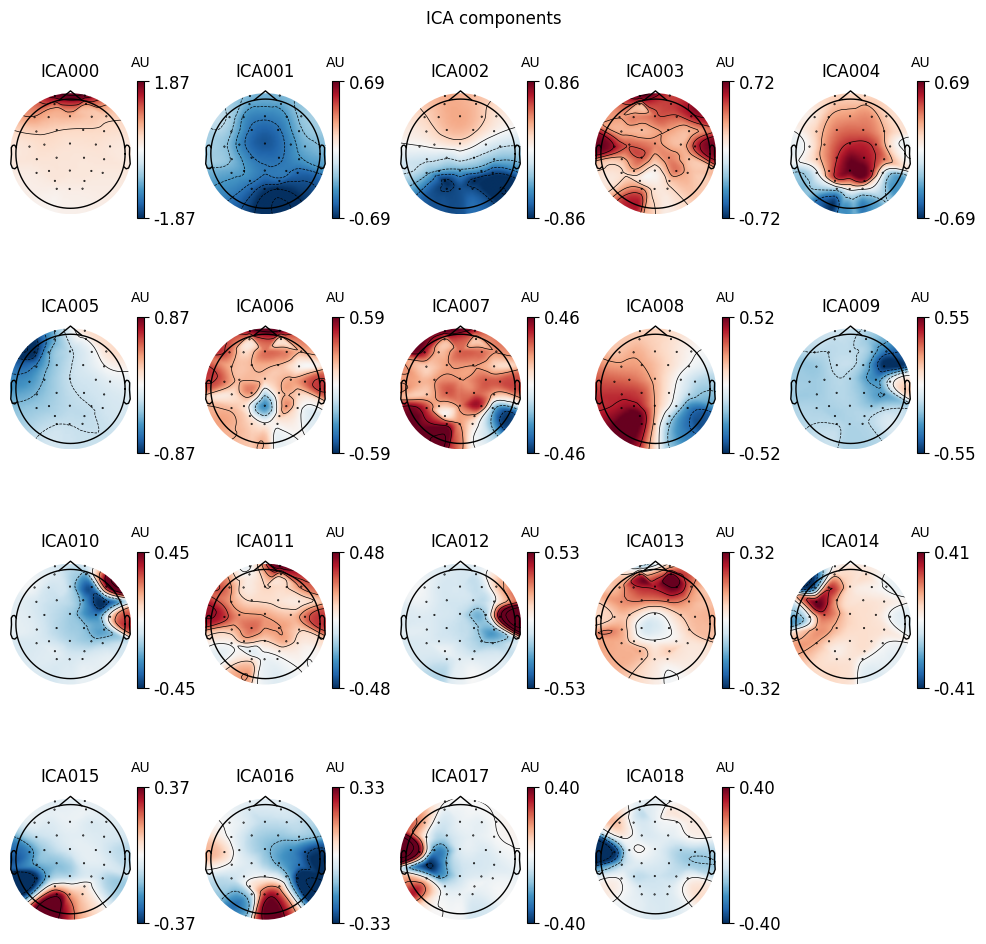









<ICA | no decomposition, method: infomax>
Fitting ICA to data using 32 channels (please be patient, this may take a while)
    Rejecting  epoch based on EEG : ['Fp1']
Artifact detected in [15100, 15200]
Selecting by number: 20 components
Computing Extended Infomax ICA
Fitting ICA took 26.1s.
<ICA | raw data decomposition, method: infomax (fit in 500 iterations on 53000 samples), 20 ICA components (32 PCA components available), channel types: eeg, no sources marked for exclusion>


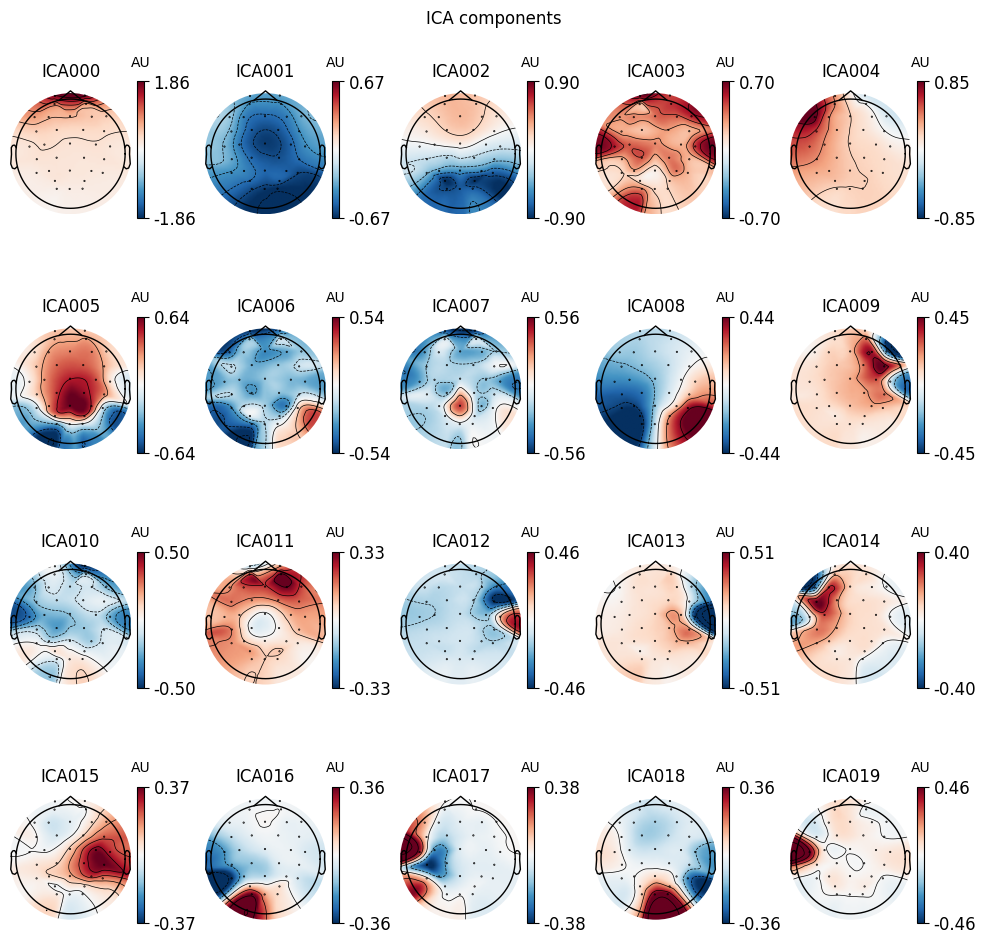

In [ ]:



method = 'infomax'   # for comparison with EEGLAB try "extended-infomax" here
decim = 10  # we need sufficient statistics, not all time points -> saves time

random_state = 97


ICAList = []


for i in range(15, 21):
  n_components = i # if float, select n_components by explained variance of PCA
  ica = mne.preprocessing.ICA(n_components=n_components, method=method, random_state=random_state,fit_params=dict(extended=True))
  print(ica)

  reject = dict(eeg=450e-6)

  ica.fit(eeg_raw,  decim=decim, reject=reject)
  print(ica)

  # ica.plot_properties(epochs, picks=0)

  %matplotlib inline
  # %matplotlib qt
  ica.plot_components(colorbar=True)  # Plot all decomposed components
  ICAList.append(ica)
  print("\n\n\n\n\n\n\n")


In [ ]:
eeg_raw.set_eeg_reference()

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


<RawEDF | P6.edf, 32 x 531500 (1063.0 s), ~129.8 MiB, data loaded>

In [ ]:
for i in range(len(ICAList)):
  ic_labels =label_components(eeg_raw, ICAList[i], method='iclabel')
  print("Number of Components =",i+15)
  print(ic_labels)
  labels = ic_labels["labels"]
  countHighAcc = 0
  for i in ic_labels["y_pred_proba"]:
    if i>0.5:
      countHighAcc+=1
  print(f"Number of high accuracies: {countHighAcc}")
  exclude_idx = [idx for idx, label in enumerate(labels) if label not in ["brain","other","muscle artifact"]]
  print(f"Excluding these ICA components: {exclude_idx}")

  exclude_idx = [idx for idx in exclude_idx if ic_labels["y_pred_proba"][idx] > 0.5]
  print(f"Finally excluding these ICA components: {exclude_idx}\n")


In [ ]:
ica = ICAList[3]
ic_labels = label_components(eeg_raw, ica, method='iclabel')
labels = ic_labels["labels"]
exclude_idx = [idx for idx, label in enumerate(labels) if label not in ["brain","other","muscle artifact"]]
print(f"Excluding these ICA components: {exclude_idx}")
exclude_idx = [idx for idx in exclude_idx if ic_labels["y_pred_proba"][idx] > 0.5]
print(f"Finally excluding these ICA components: {exclude_idx}\n")
ica.plot_properties(eeg_raw, picks=0)

In [ ]:
print(ica.plot_sources(eeg_raw))

In [ ]:
# epochs.plot(n_epochs=5)

In [ ]:
# ica.plot_overlay(epochs.average(), exclude_idx)

#Before ICA

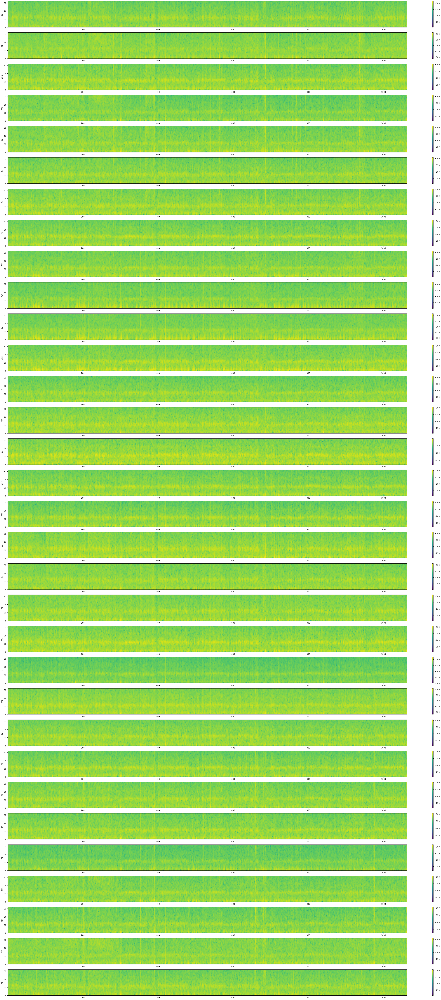

In [ ]:
figure = plt.figure(figsize=(48, 96))


markersOn = 1
for i in range(32):
  ax = figure.add_subplot(32,1,i+1)
  if markersOn:
    time_positions = np.array(triggerTimeStamps['Time Stamp'])/500
    labels = list(triggerTimeStamps['Trigger'])
    for j in range(len(time_positions)):
        ax.axvline(x=time_positions[j], color='red', linestyle='--', linewidth=1, label = labels[j])
  plt.specgram(
    list(eeg_raw._data)[i],
    NFFT=500,
    Fs=500,
    noverlap=128,
    scale_by_freq=True,
    mode='psd',
    cmap='viridis')
  plt.colorbar()
  plt.ylim(0, 32)
  plt.ylabel(f"{eeg_channels[i]}")
# figure = plt.figure(figsize=(48, 96))

# for i in range(32):
#   ax = figure.add_subplot(32,1,i+1)
#   plt.specgram(
#     list(eeg_raw._data)[i],
#     NFFT=500,
#     Fs=500,
#     noverlap=128,
#     scale_by_freq=True,
#     mode='psd',
#     cmap='viridis')
#   plt.colorbar()
#   plt.ylim(0, 32)
#   plt.ylabel(f"{eeg_channels[i]}")

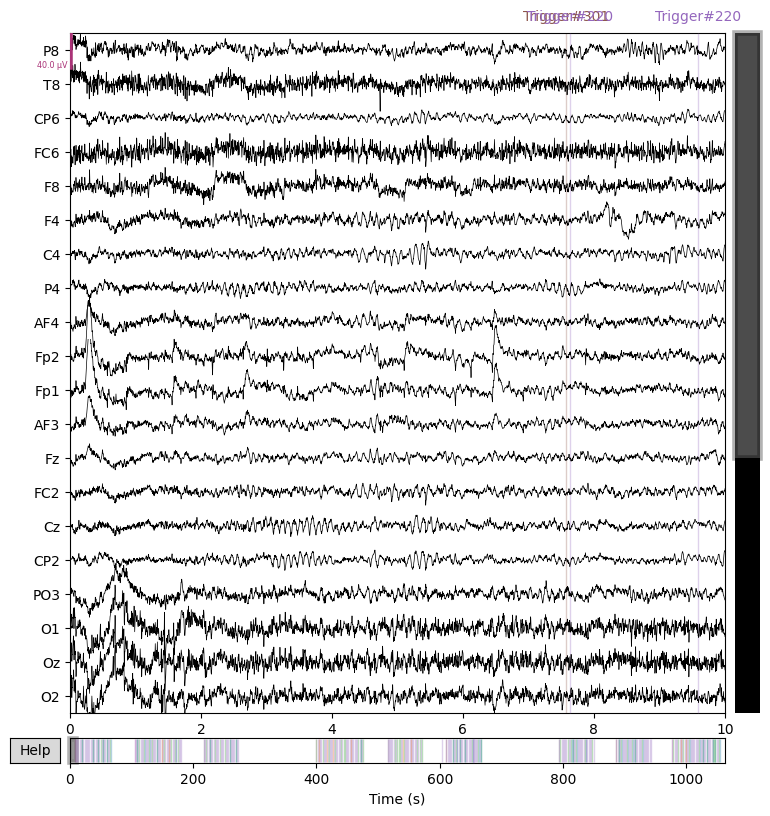

Figure(800x800)


In [ ]:
print(eeg_raw.plot())

#After ica

In [ ]:
ica.apply(eeg_raw,exclude= exclude_idx)

Applying ICA to Raw instance
    Transforming to ICA space (18 components)
    Zeroing out 1 ICA component
    Projecting back using 32 PCA components


<RawEDF | P6.edf, 32 x 531500 (1063.0 s), ~129.8 MiB, data loaded>

Creating RawArray with float64 data, n_channels=18, n_times=531500
    Range : 0 ... 531499 =      0.000 ...  1062.998 secs
Ready.


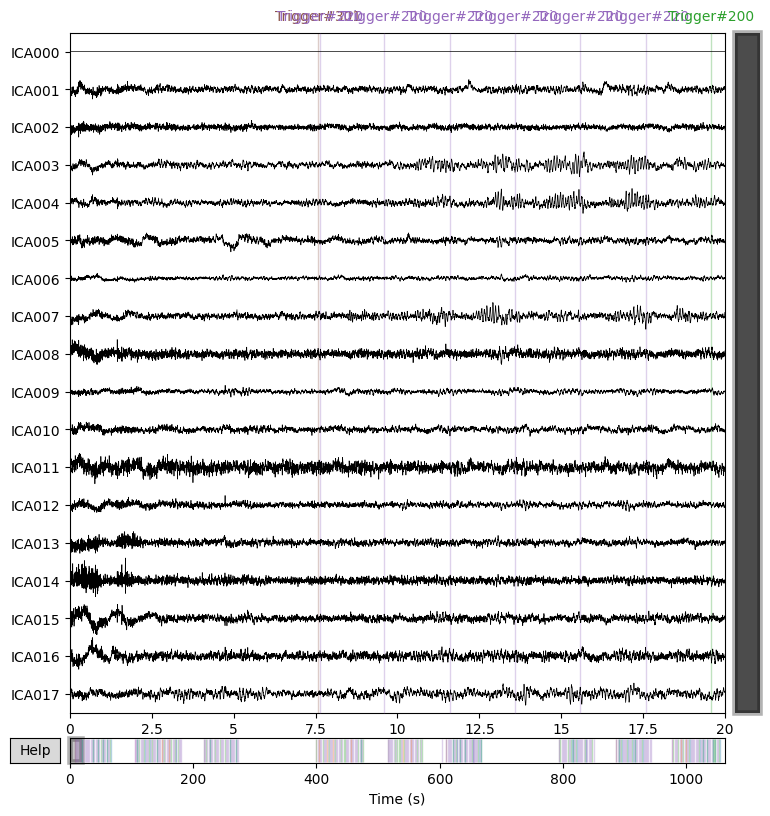

Figure(800x800)


In [ ]:
print(ica.plot_sources(eeg_raw))

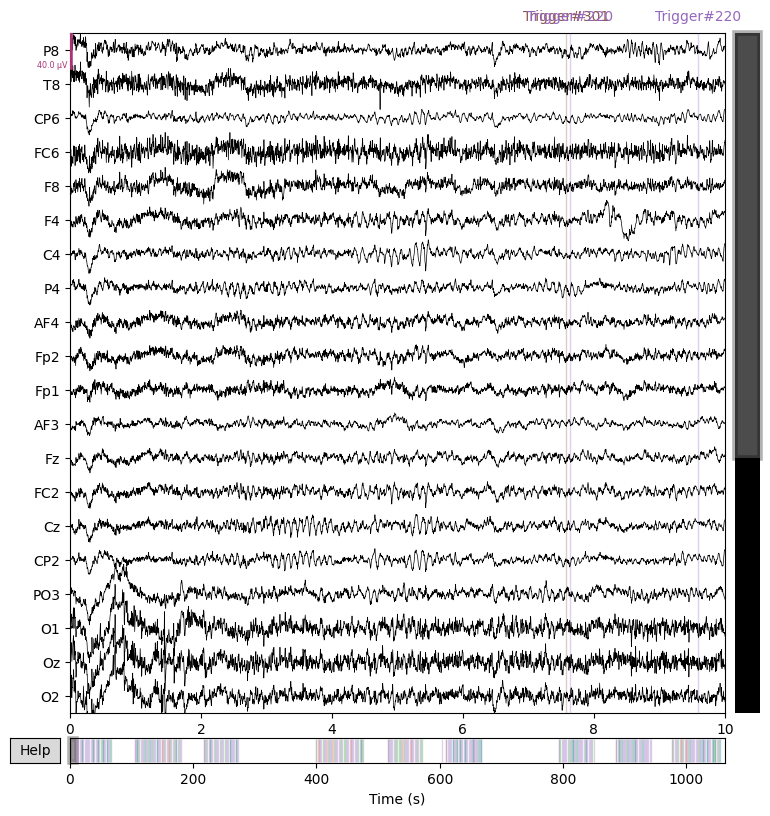

Figure(800x800)


In [ ]:
print(eeg_raw.plot())

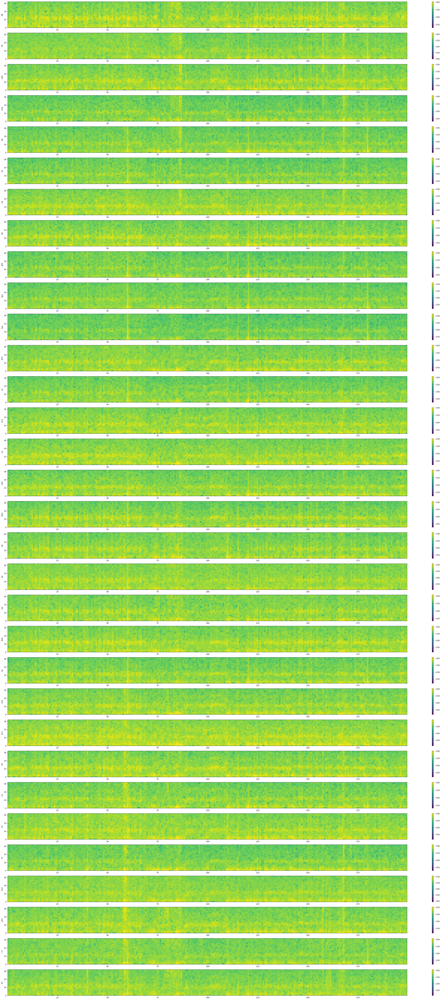

In [ ]:
figure = plt.figure(figsize=(48, 96))


markersOn = 1
for i in range(32):
  ax = figure.add_subplot(32,1,i+1)
  if markersOn:
    time_positions = np.array(triggerTimeStamps['Time Stamp'])[300000:400000]/500
    labels = list(triggerTimeStamps['Trigger'])[300000:400000]
    for j in range(len(time_positions)):
        ax.axvline(x=time_positions[j], color='red', linestyle='--', linewidth=1, label = labels[j])
  plt.specgram(
    list(eeg_raw._data)[i][300000:400000],
    NFFT=500,
    Fs=500,
    noverlap=128,
    scale_by_freq=True,
    mode='psd',
    cmap='viridis')
  plt.colorbar()
  plt.ylim(0, 32)
  plt.ylabel(f"{eeg_channels[i]}")

In [ ]:
deltaBP = []
thetaBP = []
alphaBP = []
betaBP = []
gammaBP = []
xLabels = []
startTimeStamp = 0
endTimeStamp = 0
tStart = 0
tEnd = 0
count = 0
for i in range(0,len(triggerTime)):
  count+=1
  isEndOfTrial = int(count%3 == 0)
  startTimeStamp = triggerTime[i][1]
  try:
    endTimeStamp = triggerTime[i+1][1]
  except:
    endTimeStamp = 531499

  tStart = startTimeStamp/500
  tEnd = endTimeStamp/500
  tEnd -= 30*(1-isEndOfTrial) + 120*isEndOfTrial
  if(i == len(triggerTime)-1):
    tEnd = endTimeStamp/500
  # print(f"PSD for {triggerTime[i][0][-1]}-back task")
  xLabels.append(f"{triggerTime[i][0][-1]}-back task")
  deltaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=0, fmax = 4)))))
  thetaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=4, fmax = 8)))))
  alphaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=8, fmax = 13)))))
  betaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=13, fmax = 32)))))
  gammaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=32, fmax = 100)))))
  tStart = tEnd
  tEnd += 30*(1-isEndOfTrial) + 120*isEndOfTrial
  if(i != len(triggerTime)-1):
    xLabels.append(f"{30*(1-isEndOfTrial) + 120*isEndOfTrial}s break")
    deltaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=0, fmax = 4)))))
    thetaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=4, fmax = 8)))))
    alphaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=8, fmax = 13)))))
    betaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=13, fmax = 32)))))
    gammaBP.append(np.mean(np.array(list(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd, fmin=32, fmax = 100)))))
  if(isEndOfTrial):
    print(f"----------------------------------------------------------------End of Trial {count//3}---------------------------------------------------------------")


Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective window size : 4.096 (s)
Effective wind

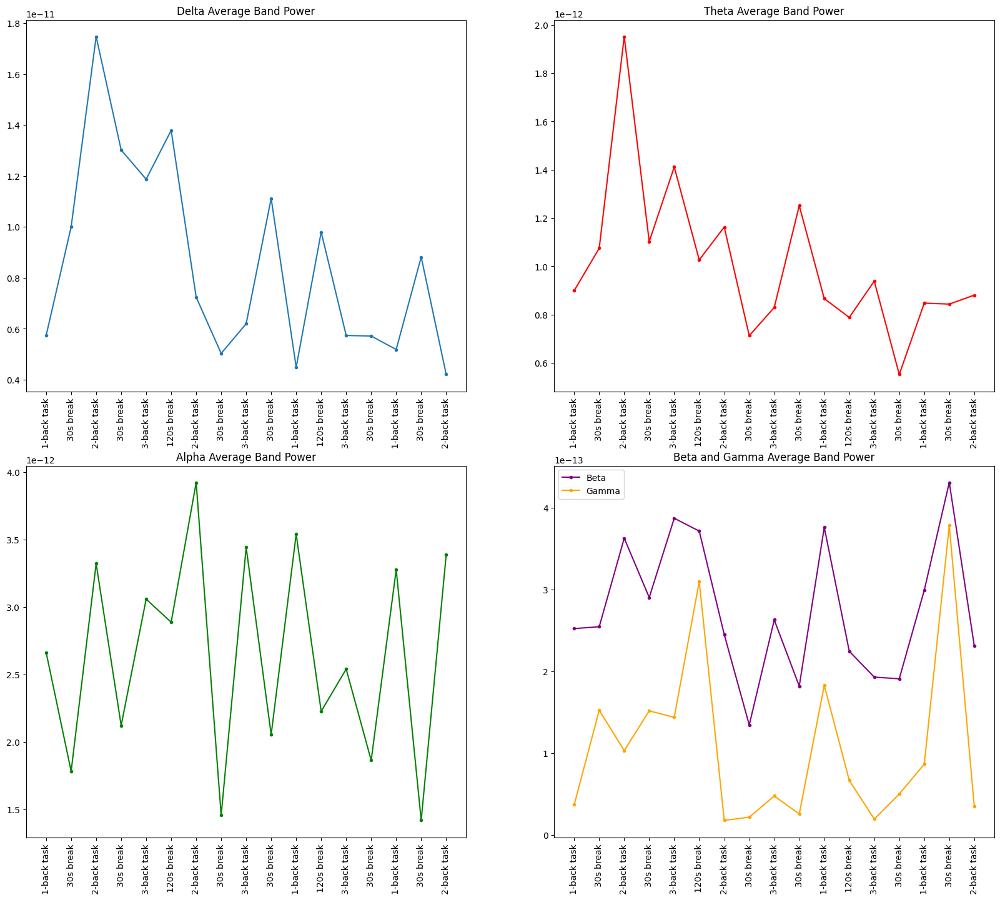

In [ ]:
import matplotlib.pyplot as plt
fig = plt.figure(figsize = (20,17))

ax1 = fig.add_subplot(2,2,1)
ax1.plot(range(len(xLabels)),deltaBP, marker=".")
plt.title("Delta Average Band Power")
plt.xticks(range(len(xLabels)),xLabels,rotation=90)

ax2 = fig.add_subplot(2,2,2)
ax2.plot(range(len(xLabels)),thetaBP, marker=".", c='r')
plt.title("Theta Average Band Power")
plt.xticks(range(len(xLabels)),xLabels,rotation=90)

ax3 = fig.add_subplot(2,2,3)
ax3.plot(range(len(xLabels)),alphaBP, marker=".", c='g')
plt.title("Alpha Average Band Power")
plt.xticks(range(len(xLabels)),xLabels,rotation=90)

ax4 = fig.add_subplot(2,2,4)
ax4.plot(range(len(xLabels)),betaBP, marker=".", c='purple')
ax4.plot(range(len(xLabels)),gammaBP, marker=".", c='orange')
plt.title("Beta and Gamma Average Band Power")
plt.xticks(range(len(xLabels)),xLabels,rotation=90)

# plt.title("Trends of average band power for the course of the experiment")
# plt.xticks(range(len(xLabels)),xLabels,rotation=90)
plt.legend(labels=['Beta', 'Gamma'])

PSD for 1-back task
Effective window size : 4.096 (s)


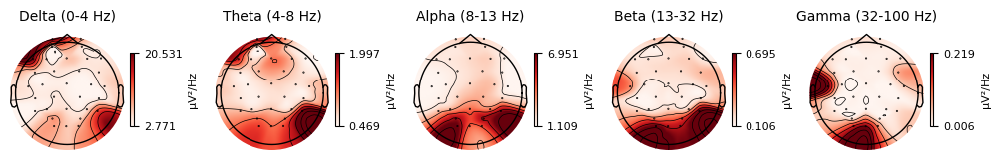

Figure(1000x150)
PSD for 2-back task
Effective window size : 4.096 (s)


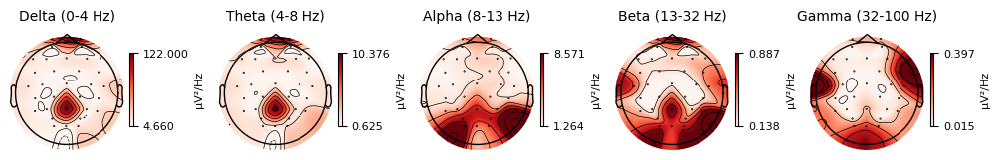

Figure(1000x150)
PSD for 3-back task
Effective window size : 4.096 (s)


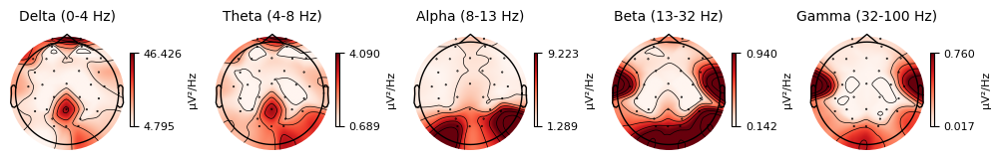

Figure(1000x150)
----------------------------------------------------------------End of Trial 1---------------------------------------------------------------
PSD for 2-back task
Effective window size : 4.096 (s)


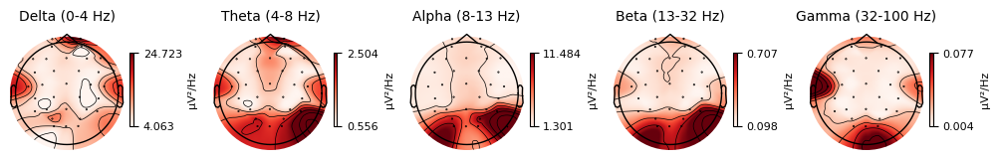

Figure(1000x150)
PSD for 3-back task
Effective window size : 4.096 (s)


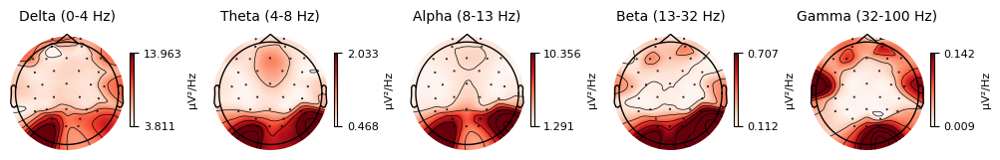

Figure(1000x150)
PSD for 1-back task
Effective window size : 4.096 (s)


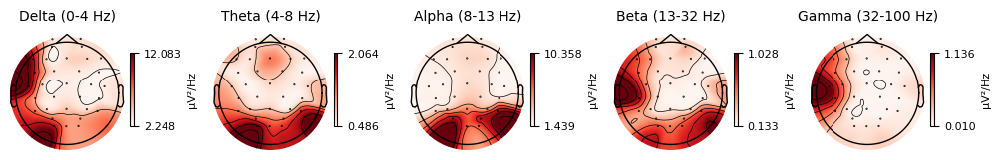

Figure(1000x150)
----------------------------------------------------------------End of Trial 2---------------------------------------------------------------
PSD for 3-back task
Effective window size : 4.096 (s)


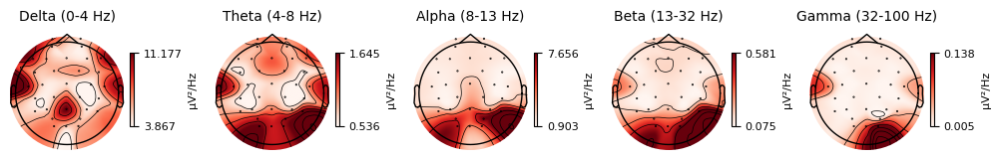

Figure(1000x150)
PSD for 1-back task
Effective window size : 4.096 (s)


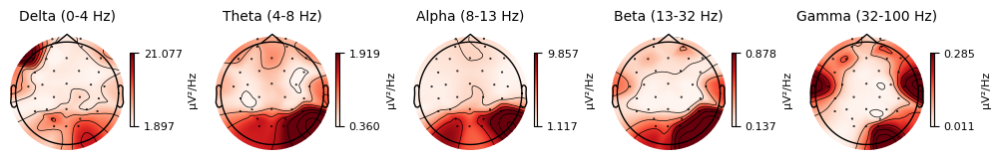

Figure(1000x150)
PSD for 2-back task
Effective window size : 4.096 (s)


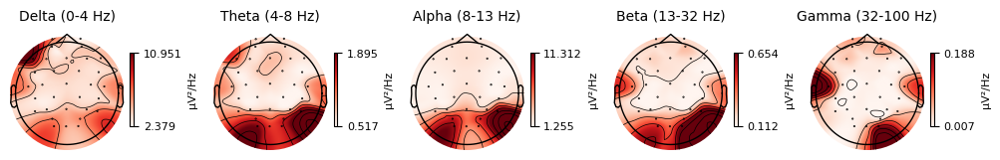

Figure(1000x150)
----------------------------------------------------------------End of Trial 3---------------------------------------------------------------


In [ ]:
triggerTime
startTimeStamp = 0
endTimeStamp = 0
tStart = 0
tEnd = 0
count = 0
for i in range(0,len(triggerTime)):
  count+=1
  isEndOfTrial = int(count%3 == 0)
  startTimeStamp = triggerTime[i][1]
  try:
    endTimeStamp = triggerTime[i+1][1]
  except:
    endTimeStamp = 531499
  tStart = startTimeStamp/500
  tEnd = endTimeStamp/500
  tEnd -= 30*(1-isEndOfTrial) + 120*isEndOfTrial
  if(i == len(triggerTime)-1):
    tEnd = endTimeStamp/500
  print(f"PSD for {triggerTime[i][0][-1]}-back task")
  print(eeg_raw.compute_psd(tmin=tStart, tmax=tEnd).plot_topomap(bands)) ############################################
  if(isEndOfTrial):
    print(f"----------------------------------------------------------------End of Trial {count//3}---------------------------------------------------------------")


In [ ]:
# 1 back, 2 back, 3 back, 30s, 120s
deltaAvgPower = [(deltaBP[0]+deltaBP[10]+deltaBP[14])/3, (deltaBP[2]+deltaBP[6]+deltaBP[16])/3, (deltaBP[4]+deltaBP[8]+deltaBP[12])/3, (deltaBP[1]+deltaBP[3]+deltaBP[7]+deltaBP[9]+deltaBP[13]+deltaBP[15])/3, (deltaBP[5]+deltaBP[11])/3]
thetaAvgPower = [(thetaBP[0]+thetaBP[10]+thetaBP[14])/3, (thetaBP[2]+thetaBP[6]+thetaBP[16])/3, (thetaBP[4]+thetaBP[8]+thetaBP[12])/3, (thetaBP[1]+thetaBP[3]+thetaBP[7]+thetaBP[9]+thetaBP[13]+thetaBP[15])/3, (thetaBP[5]+thetaBP[11])/3]
alphaAvgPower = [(alphaBP[0]+alphaBP[10]+alphaBP[14])/3, (alphaBP[2]+alphaBP[6]+alphaBP[16])/3, (alphaBP[4]+alphaBP[8]+alphaBP[12])/3, (alphaBP[1]+alphaBP[3]+alphaBP[7]+alphaBP[9]+alphaBP[13]+alphaBP[15])/3, (alphaBP[5]+alphaBP[11])/3]
betaAvgPower = [(betaBP[0]+betaBP[10]+betaBP[14])/3, (betaBP[2]+betaBP[6]+betaBP[16])/3, (betaBP[4]+betaBP[8]+betaBP[12])/3, (betaBP[1]+betaBP[3]+betaBP[7]+betaBP[9]+betaBP[13]+betaBP[15])/3, (betaBP[5]+betaBP[11])/3]
gammaAvgPower = [(gammaBP[0]+gammaBP[10]+gammaBP[14])/3, (gammaBP[2]+gammaBP[6]+gammaBP[16])/3, (gammaBP[4]+gammaBP[8]+gammaBP[12])/3, (gammaBP[1]+gammaBP[3]+gammaBP[7]+gammaBP[9]+gammaBP[13]+gammaBP[15])/3, (gammaBP[5]+gammaBP[11])/3]


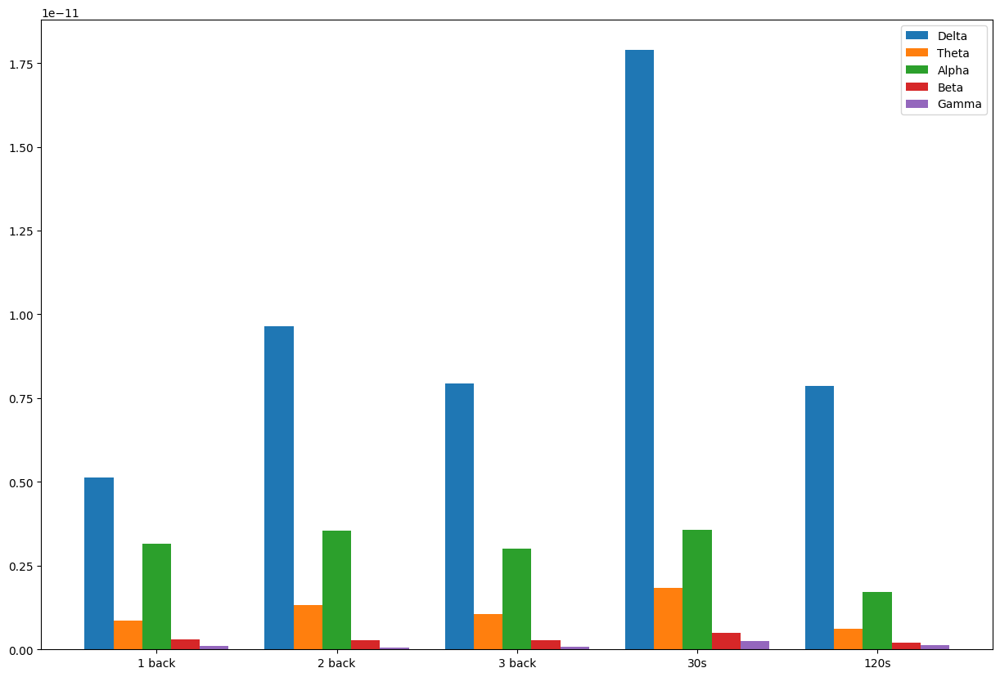

In [ ]:
toggleLabels = 0

def add_labels(x, y, offset = 0, labelsOn = 0):
    if(labelsOn):
      for i in range(len(x)):
          plt.text(i+offset, y[i], round(y[i], 14), ha='center')
    else:
      return
arr = np.array([0,1,2,3,4])
plt.figure(figsize=(15,10))
plt.bar(arr, deltaAvgPower, width=0.16)
add_labels(arr, deltaAvgPower, labelsOn = toggleLabels)

plt.bar(arr+0.16, thetaAvgPower, width=0.16)
add_labels(arr, thetaAvgPower, 0.16, labelsOn = toggleLabels)

plt.bar(arr+0.32, alphaAvgPower, width=0.16)
add_labels(arr, alphaAvgPower, 0.32, labelsOn = toggleLabels)

plt.bar(arr+0.48, betaAvgPower, width=0.16)
add_labels(arr, betaAvgPower, 0.48, labelsOn = toggleLabels)

plt.bar(arr+0.64, gammaAvgPower, width=0.16)
add_labels(arr, gammaAvgPower, 0.60, labelsOn = toggleLabels)





plt.xticks(arr+0.32, ['1 back', '2 back', '3 back', '30s', '120s'])
plt.legend( labels = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma'])

In [ ]:
# eeg_raw.save('RemovedArtifactsEEG.fif')

In [ ]:
# four.plot()
